In [1]:
import tensorflow as tf
import tensorflow_hub as hub

print("TF version:", tf.__version__)
print("Hub version:", hub.__version__)

print("GPU", "available (YESS!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

TF version: 2.17.0
Hub version: 0.16.1
GPU available (YESS!!!!)


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import pandas as pd
labels_csv = pd.read_csv("/content/drive/MyDrive/Dog-vision/dog-breed-identification/labels.csv")
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


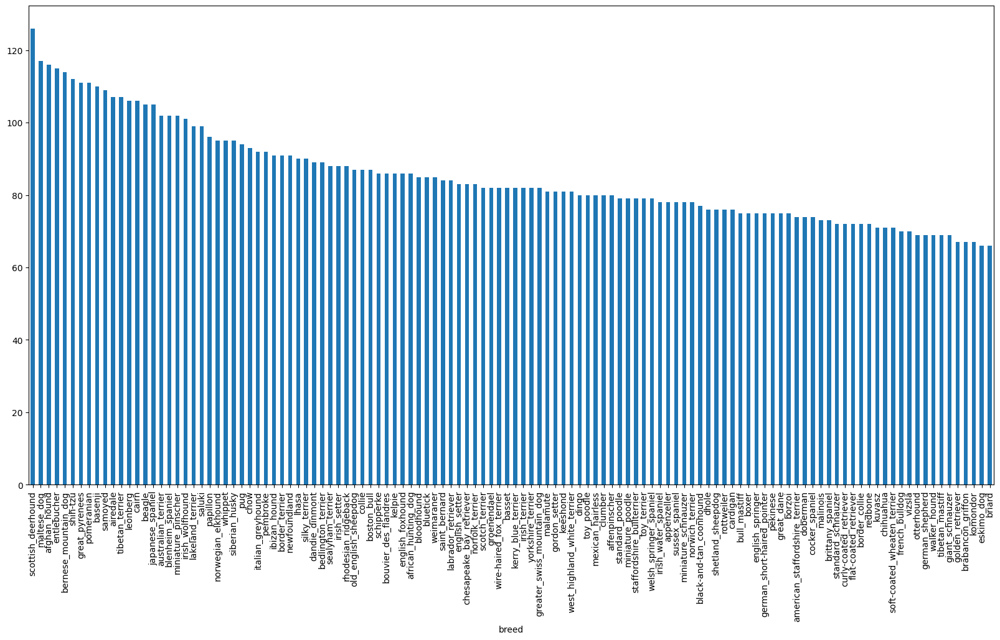

In [4]:
labels_csv["breed"].value_counts().plot.bar(figsize=(20, 10));

In [5]:
from IPython.display import display, Image

In [6]:
filenames = ["/content/drive/MyDrive/Dog-vision/dog-breed-identification/train/" + fname + ".jpg" for fname in labels_csv["id"]]

filenames[:10]

['/content/drive/MyDrive/Dog-vision/dog-breed-identification/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-identification/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-identification/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-identification/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-identification/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-identification/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-identification/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-identification/train/002a283a315af96eaea0e28e7163b21b.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-identification/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-

In [7]:
import os
if len(os.listdir("/content/drive/MyDrive/Dog-vision/dog-breed-identification/train/")) == len(filenames):
  print("Filenames match actual amount of files!")
else:
  print("Filenames do not match actual amount of files, check the target directory.")

Filenames match actual amount of files!


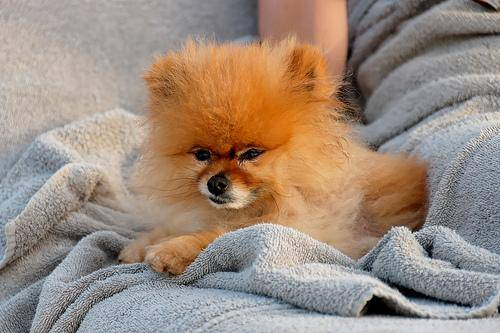

In [8]:
Image(filenames[8000])

In [9]:
import numpy as np
labels = labels_csv["breed"].to_numpy()
labels[:10]

array(['boston_bull', 'dingo', 'pekinese', 'bluetick', 'golden_retriever',
       'bedlington_terrier', 'bedlington_terrier', 'borzoi', 'basenji',
       'scottish_deerhound'], dtype=object)

In [10]:
if len(labels) == len(filenames):
  print("Number of labels matches number of filenames!")
else:
  print("Number of labels does not match number of filenames, check data directories.")

Number of labels matches number of filenames!


In [11]:
unique_breeds = np.unique(labels)
len(unique_breeds)

120

In [12]:
print(labels[0])
labels[0] == unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [13]:
boolean_labels = [label == np.array(unique_breeds) for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [14]:
print(labels[0])
print(np.where(unique_breeds == labels[0])[0][0])
print(boolean_labels[0].argmax())
print(boolean_labels[0].astype(int))

boston_bull
19
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [15]:
X = filenames
y = boolean_labels

In [16]:
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}
NUM_IMAGES

1000

In [17]:
from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2,
                                                  random_state=42)

len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [18]:
X_train[:5], y_train[:2]

(['/content/drive/MyDrive/Dog-vision/dog-breed-identification/train/00bee065dcec471f26394855c5c2f3de.jpg',
  '/content/drive/MyDrive/Dog-vision/dog-breed-identification/train/0d2f9e12a2611d911d91a339074c8154.jpg',
  '/content/drive/MyDrive/Dog-vision/dog-breed-identification/train/1108e48ce3e2d7d7fb527ae6e40ab486.jpg',
  '/content/drive/MyDrive/Dog-vision/dog-breed-identification/train/0dc3196b4213a2733d7f4bdcd41699d3.jpg',
  '/content/drive/MyDrive/Dog-vision/dog-breed-identification/train/146fbfac6b5b1f0de83a5d0c1b473377.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, Fa

In [19]:
from matplotlib.pyplot import imread
image = imread(filenames[42])
image.shape

(257, 350, 3)

In [20]:
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  89],
        [ 76, 124,  76],
        [ 63, 111,  61],
        ...,
        [ 77, 133,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  75],
        [ 67, 114,  68],
        [ 63, 110,  64],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 132,  84]]], dtype=uint8)>

In [21]:
IMG_SIZE = 224

def process_image(image_path):

  image = tf.io.read_file(image_path)
  image = tf.image.decode_jpeg(image, channels=3)
  image = tf.image.convert_image_dtype(image, tf.float32)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])
  return image

In [22]:
def get_image_label(image_path, label):

  image = process_image(image_path)
  return image, label

In [23]:
BATCH_SIZE = 32

def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):

  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x)))
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x),
                                               tf.constant(y)))
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    print("Creating training data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x),
                                              tf.constant(y)))

    data = data.shuffle(buffer_size=len(x))

    data = data.map(get_image_label)

    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [24]:
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [25]:
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

In [26]:
import matplotlib.pyplot as plt

def show_25_images(images, labels):

  plt.figure(figsize=(10, 10))
  for i in range(25):
    ax = plt.subplot(5, 5, i+1)
    plt.imshow(images[i])
    plt.title(unique_breeds[labels[i].argmax()])
    plt.axis("off")

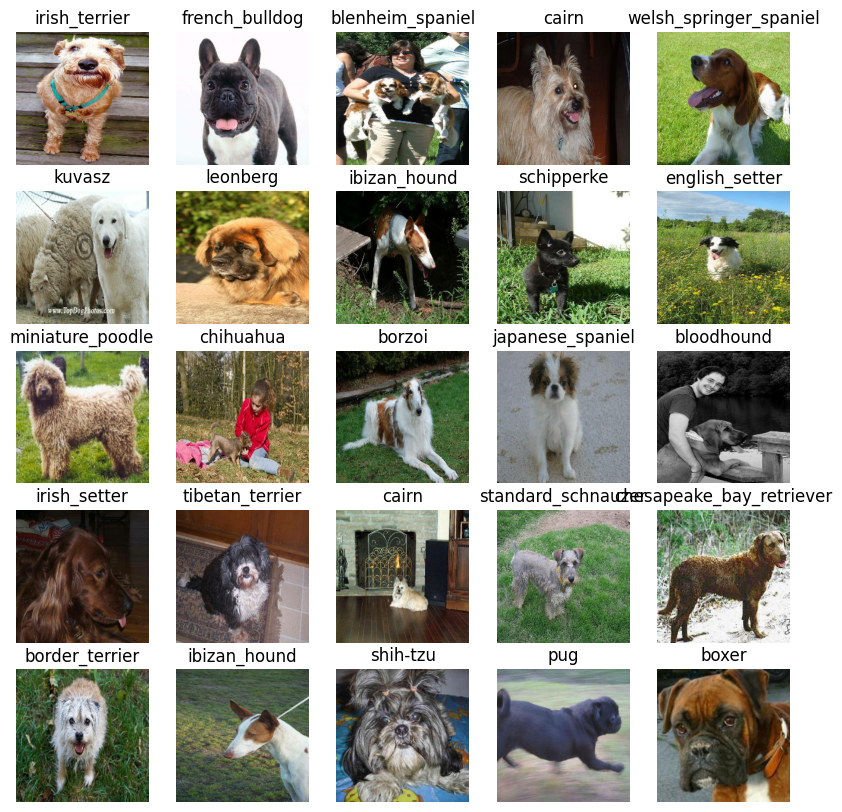

In [27]:
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

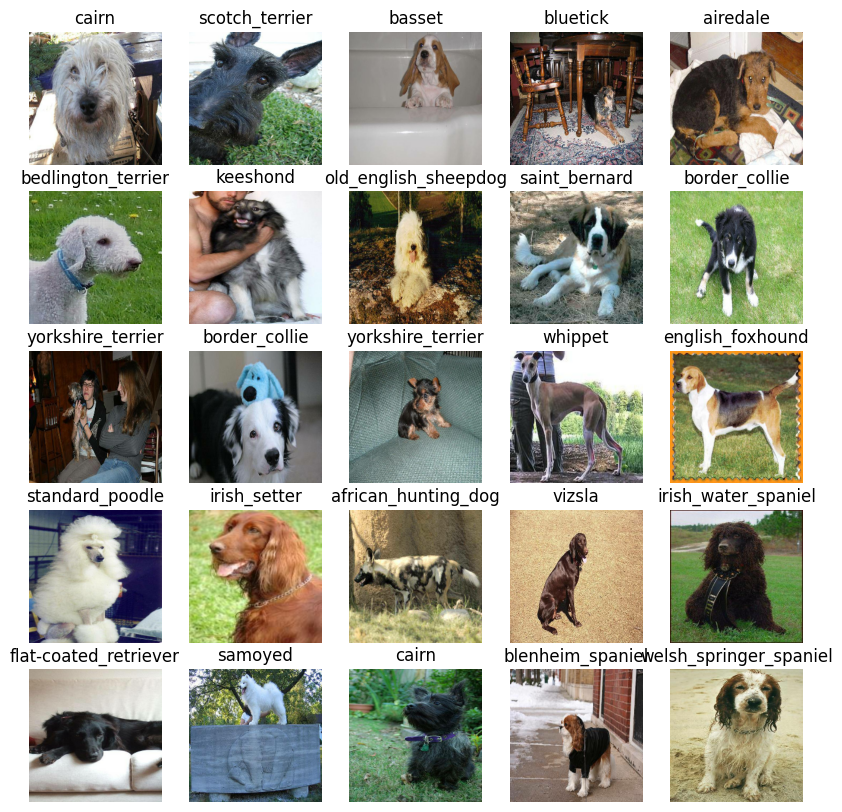

In [28]:
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

In [29]:
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3]

OUTPUT_SHAPE = len(unique_breeds)

MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

In [30]:
pip install tf_keras

In [31]:
import tf_keras
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  model = tf_keras.Sequential([
    hub.KerasLayer(MODEL_URL),
    tf_keras.layers.Dense(units=OUTPUT_SHAPE,
                          activation="softmax")
  ])

  model.compile(
      loss=tf_keras.losses.CategoricalCrossentropy(),
      optimizer=tf_keras.optimizers.Adam(),
      metrics=["accuracy"]
  )

  model.build(INPUT_SHAPE)

  return model

In [32]:
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5552953 (21.18 MB)
Trainable params: 120240 (469.69 KB)
Non-trainable params: 5432713 (20.72 MB)
_________________________________________________________________


In [33]:
%load_ext tensorboard

In [34]:
import datetime

def create_tensorboard_callback():
  logdir = os.path.join("/content/drive/MyDrive/Dog-vision/logs",
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf_keras.callbacks.TensorBoard(logdir)

In [35]:
early_stopping = tf_keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3)

In [36]:
NUM_EPOCHS = 100 #@param {type:"slider", min:10, max:100, step:10}

In [37]:
def train_model():

  model = create_model()

  tensorboard = create_tensorboard_callback()

  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1,
            callbacks=[tensorboard, early_stopping])

  return model

In [38]:
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
25/25 [==============================] - 155s 6s/step - loss: 4.8368 - accuracy: 0.0550 - val_loss: 3.4854 - val_accuracy: 0.2350
Epoch 2/100
25/25 [==============================] - 4s 166ms/step - loss: 1.7831 - accuracy: 0.6612 - val_loss: 2.1935 - val_accuracy: 0.5100
Epoch 3/100
25/25 [==============================] - 4s 168ms/step - loss: 0.6143 - accuracy: 0.9362 - val_loss: 1.6491 - val_accuracy: 0.5950
Epoch 4/100
25/25 [==============================] - 5s 197ms/step - loss: 0.2736 - accuracy: 0.9825 - val_loss: 1.4832 - val_accuracy: 0.6300
Epoch 5/100
25/25 [==============================] - 4s 148ms/step - loss: 0.1575 - accuracy: 0.9962 - val_loss: 1.3952 - val_accuracy: 0.6650
Epoch 6/100
25/25 [==============================] - 4s 149ms/step - loss: 0.1063 - accuracy: 0.9987 - val_loss: 1.3450 - val_accuracy: 0.6800
Epoch 7/100
25/25 [==============================]

In [39]:
%tensorboard --logdir drive/My\ Drive/Dog-vision/logs

<IPython.core.display.Javascript object>

In [40]:
predictions = model.predict(val_data, verbose=1)
predictions

7/7 [==============================] - 41s 112ms/step


array([[2.57287011e-03, 1.69564330e-04, 2.50752131e-03, ...,
        3.09252151e-04, 3.29071154e-05, 3.97827337e-03],
       [1.94893545e-03, 4.05290106e-04, 2.10301206e-02, ...,
        5.00200666e-04, 6.33171643e-04, 1.23192367e-04],
       [6.43708927e-06, 7.99606551e-06, 3.57637728e-05, ...,
        1.08015101e-05, 4.32404231e-05, 3.09248244e-05],
       ...,
       [1.28504662e-05, 1.41203622e-04, 3.68183428e-05, ...,
        1.28713773e-05, 3.20384745e-04, 1.47366503e-04],
       [3.81393568e-03, 1.49852436e-04, 7.21103512e-04, ...,
        1.09745575e-04, 5.86220849e-05, 6.58644596e-03],
       [1.23138961e-04, 1.70990297e-05, 9.27021669e-04, ...,
        1.78252384e-02, 2.52461672e-04, 1.35216527e-04]], dtype=float32)

In [41]:
predictions.shape

(200, 120)

In [42]:
print(predictions[0])
print(f"Max value (probability of prediction): {np.max(predictions[0])}")
print(f"Sum: {np.sum(predictions[0])}")
print(f"Max index: {np.argmax(predictions[0])}")
print(f"Predicted label: {unique_breeds[np.argmax(predictions[0])]}")

[2.57287011e-03 1.69564330e-04 2.50752131e-03 7.60794283e-05
 3.69955203e-04 6.18261256e-05 6.12158626e-02 3.25133180e-04
 3.48652189e-04 1.10927511e-04 1.13182655e-03 6.63966290e-04
 2.85977352e-04 1.28356682e-04 5.69229946e-04 9.31619434e-04
 1.23581107e-04 6.54886663e-02 1.70999301e-05 1.05120955e-04
 3.97744850e-04 2.85368616e-04 2.52797527e-05 9.37733147e-03
 2.01256014e-04 4.94781707e-05 4.31688458e-01 9.48149318e-05
 1.10907196e-04 4.50461346e-04 3.84533523e-05 1.51755044e-03
 4.09032567e-04 1.20071025e-04 4.53499306e-05 1.43788671e-02
 3.49706970e-05 1.44751696e-03 1.04483996e-04 2.03277043e-04
 1.37488265e-03 6.56040138e-05 6.34403477e-05 5.01575531e-04
 2.12596860e-05 3.43602180e-04 2.56397005e-04 2.34615509e-04
 6.16278325e-04 2.84631649e-04 2.72057950e-04 7.21558899e-05
 5.69155556e-04 2.15711971e-05 2.47879099e-04 3.10768082e-05
 2.40772555e-04 1.82167825e-03 4.03283135e-04 7.87511319e-02
 7.07325817e-04 5.42356720e-05 1.97614590e-03 1.30886601e-05
 6.17374259e-04 5.453965

In [43]:
def get_pred_label(prediction_probabilities):
  return unique_breeds[np.argmax(prediction_probabilities)]

pred_label = get_pred_label(predictions[0])
pred_label

'cairn'

In [44]:
def unbatchify(data):

  images = []
  labels = []
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [45]:
def plot_pred(prediction_probabilities, labels, images, n=1):

  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  pred_label = get_pred_label(pred_prob)

  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)

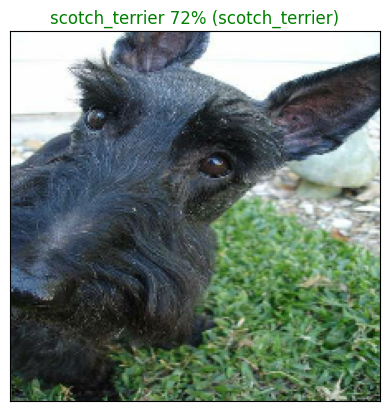

In [46]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images)

In [47]:
def plot_pred_conf(prediction_probabilities, labels, n=1):

  pred_prob, true_label = prediction_probabilities[n], labels[n]

  pred_label = get_pred_label(pred_prob)

  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

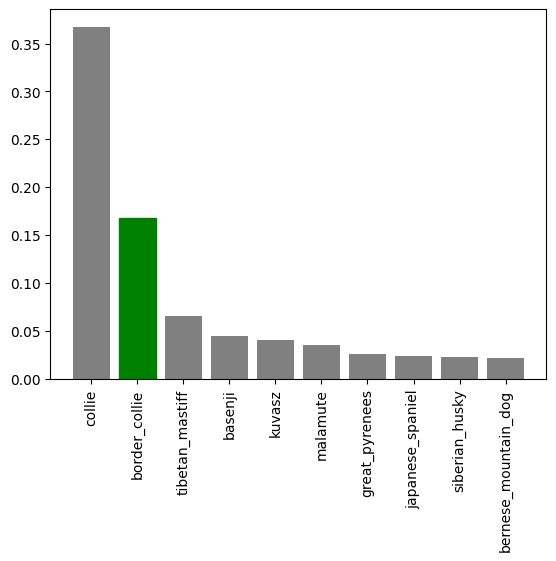

In [48]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=9)

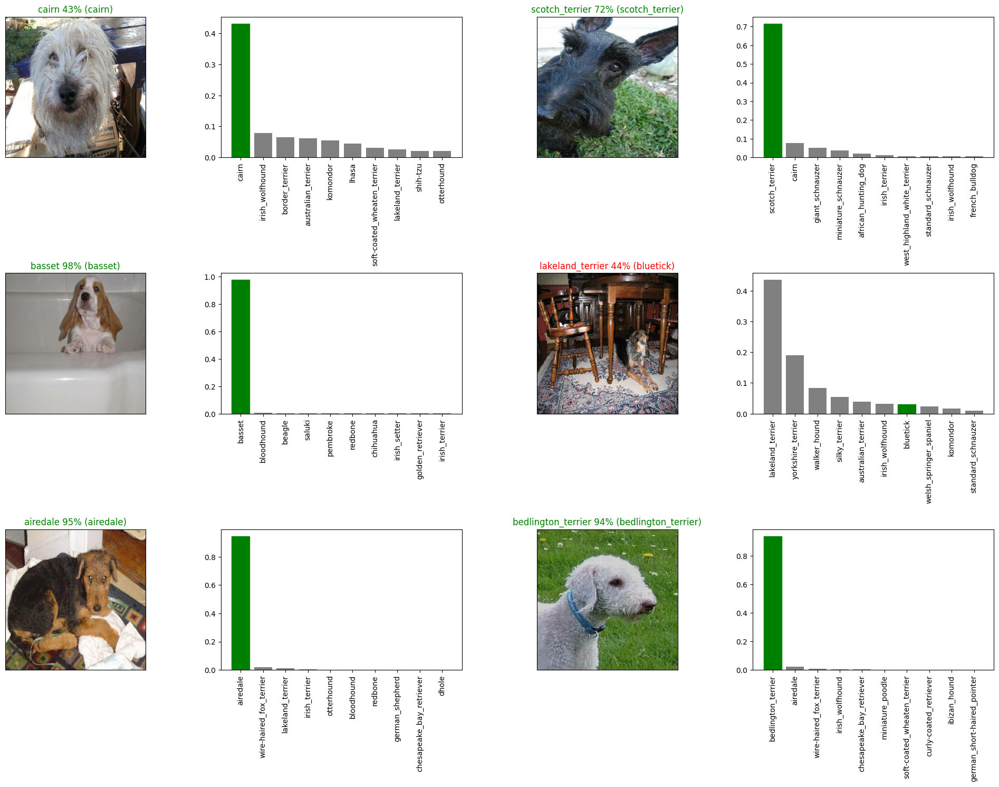

In [49]:
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

In [50]:
def save_model(model, suffix=None):

  modeldir = os.path.join("drive/My Drive/Dog-vision/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5"
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [51]:
def load_model(model_path):

  print(f"Loading saved model from: {model_path}")
  model = tf_keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [52]:
save_model(model, suffix="1000-images-Adam")

Saving model to: drive/My Drive/Dog-vision/models/20240828-16361724862979-1000-images-Adam.h5...


/usr/local/lib/python3.10/dist-packages/tf_keras/src/engine/training.py:3098: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native TF-Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'drive/My Drive/Dog-vision/models/20240828-16361724862979-1000-images-Adam.h5'

In [53]:
model_1000_images = load_model('drive/My Drive/Dog-vision/models/20240824-05431724478205-1000-images-Adam.h5')

Loading saved model from: drive/My Drive/Dog-vision/models/20240824-05431724478205-1000-images-Adam.h5


In [54]:
model.evaluate(val_data)

7/7 [==============================] - 1s 102ms/step - loss: 1.2282 - accuracy: 0.6900


[1.228234052658081, 0.6899999976158142]

In [55]:
model_1000_images.evaluate(val_data)

7/7 [==============================] - 2s 171ms/step - loss: 1.2839 - accuracy: 0.7050


[1.2838996648788452, 0.7049999833106995]

In [56]:
len(X), len(y)

(10222, 10222)

In [57]:
full_data = create_data_batches(X, y)

Creating training data batches...


In [58]:
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [59]:
full_model_tensorboard = create_tensorboard_callback()

full_model_early_stopping = tf_keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

In [60]:
%tensorboard --logdir drive/My\ Drive/Dog-vision/logs

Reusing TensorBoard on port 6006 (pid 3877), started 0:03:32 ago. (Use '!kill 3877' to kill it.)

<IPython.core.display.Javascript object>

In [61]:
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard,
                          full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 1320s 4s/step - loss: 1.3351 - accuracy: 0.6740
Epoch 2/100
320/320 [==============================] - 43s 135ms/step - loss: 0.4001 - accuracy: 0.8832
Epoch 3/100
320/320 [==============================] - 44s 136ms/step - loss: 0.2405 - accuracy: 0.9327
Epoch 4/100
320/320 [==============================] - 43s 134ms/step - loss: 0.1576 - accuracy: 0.9625
Epoch 5/100
320/320 [==============================] - 43s 136ms/step - loss: 0.1065 - accuracy: 0.9789
Epoch 6/100
320/320 [==============================] - 43s 133ms/step - loss: 0.0786 - accuracy: 0.9857
Epoch 7/100
320/320 [==============================] - 43s 133ms/step - loss: 0.0586 - accuracy: 0.9917
Epoch 8/100
320/320 [==============================] - 41s 129ms/step - loss: 0.0468 - accuracy: 0.9948
Epoch 9/100
320/320 [==============================] - 41s 129ms/step - loss: 0.0378 - accuracy: 0.9955
Epoch 10/100
320/320 [==============================] - 42s 130ms

In [62]:
save_model(full_model, suffix="all-images-Adam")

Saving model to: drive/My Drive/Dog-vision/models/20240828-17181724865535-all-images-Adam.h5...


'drive/My Drive/Dog-vision/models/20240828-17181724865535-all-images-Adam.h5'

In [63]:
loaded_full_model = load_model('drive/My Drive/Dog-vision/models/20240824-06311724481080-all-images-Adam.h5')

Loading saved model from: drive/My Drive/Dog-vision/models/20240824-06311724481080-all-images-Adam.h5


In [64]:
test_path = "/content/drive/MyDrive/Dog-vision/dog-breed-identification/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]

test_filenames[:10]

['/content/drive/MyDrive/Dog-vision/dog-breed-identification/test/e7afcce6e45858fc3b294cc5c0b15a53.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-identification/test/e7ed96b272013c6de9505a753816ce75.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-identification/test/e8232c9a79f0e77e9b4c5fca60682d41.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-identification/test/e85291fc6ba44e39defc7769fa020646.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-identification/test/e85d4e2707683df0e6387e19b67b873d.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-identification/test/e8319b1410a984291d71a3e60c84d86c.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-identification/test/e85b19a69be67eaef9fe58b7e689ee81.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-identification/test/e823ee1ca007c88600806925a6f2bce1.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-identification/test/e83d7fa8fdfba0ec577f9c8df811d439.jpg',
 '/content/drive/MyDrive/Dog-vision/dog-breed-identific

In [65]:
len(test_filenames)

10367

In [66]:
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches...


In [67]:
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

324/324 [==============================] - 221s 666ms/step


In [68]:
test_predictions[:10]

array([[6.59509748e-02, 1.26781899e-07, 2.13534435e-09, ...,
        1.60878644e-09, 3.18255360e-08, 3.54317194e-07],
       [1.09734195e-07, 3.03003445e-09, 2.42548204e-09, ...,
        1.40823442e-09, 3.80224037e-07, 1.84707774e-03],
       [7.89171083e-13, 1.75655430e-06, 3.16214242e-11, ...,
        2.06607931e-09, 2.21530740e-07, 4.56989957e-09],
       ...,
       [4.61812526e-08, 1.61961179e-05, 2.88390254e-08, ...,
        2.13817384e-06, 1.49302213e-02, 2.74275340e-06],
       [1.58584812e-09, 3.86338606e-09, 2.17854988e-11, ...,
        9.16883722e-11, 2.88657778e-11, 1.49637405e-08],
       [5.66764378e-08, 4.21273505e-08, 5.37475175e-09, ...,
        5.01492991e-07, 1.11447079e-07, 1.97550776e-09]], dtype=float32)

In [69]:
preds_df = pd.DataFrame(columns=["id"] + list(unique_breeds))
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [70]:
test_path = "/content/drive/MyDrive/Dog-vision/dog-breed-identification/test/"
preds_df["id"] = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e7afcce6e45858fc3b294cc5c0b15a53,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,e7ed96b272013c6de9505a753816ce75,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,e8232c9a79f0e77e9b4c5fca60682d41,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,e85291fc6ba44e39defc7769fa020646,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,e85d4e2707683df0e6387e19b67b873d,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [71]:
preds_df[list(unique_breeds)] = test_predictions
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e7afcce6e45858fc3b294cc5c0b15a53,6.595097e-02,1.267819e-07,2.135344e-09,1.533207e-09,2.079622e-09,3.137633e-11,7.715675e-07,7.949376e-11,2.242477e-11,...,1.176213e-06,5.146656e-08,6.509545e-08,2.095949e-09,4.713302e-10,2.190608e-12,3.063360e-11,1.608786e-09,3.182554e-08,3.543172e-07
1,e7ed96b272013c6de9505a753816ce75,1.097342e-07,3.030034e-09,2.425482e-09,3.986485e-07,2.198227e-07,2.152931e-10,9.920655e-01,8.205695e-08,4.768296e-09,...,2.270802e-07,8.254067e-06,3.374505e-07,9.372249e-09,9.614155e-10,2.295057e-08,2.647045e-07,1.408234e-09,3.802240e-07,1.847078e-03
2,e8232c9a79f0e77e9b4c5fca60682d41,7.891711e-13,1.756554e-06,3.162142e-11,2.262642e-07,9.085872e-12,3.926041e-10,1.969150e-11,2.146487e-12,1.749057e-07,...,1.461434e-11,9.811461e-11,7.158888e-10,1.230667e-08,1.033835e-09,8.835276e-10,9.143481e-13,2.066079e-09,2.215307e-07,4.569900e-09
3,e85291fc6ba44e39defc7769fa020646,8.592567e-10,3.069681e-07,8.031979e-06,3.848322e-07,6.476760e-07,2.014213e-06,3.906597e-10,5.491500e-09,1.356777e-05,...,2.768895e-06,2.087112e-06,6.153738e-03,4.133866e-08,4.002660e-05,4.740293e-07,2.391763e-08,1.322960e-02,9.312881e-11,3.646322e-08
4,e85d4e2707683df0e6387e19b67b873d,7.209435e-08,2.807368e-10,5.418977e-10,3.747177e-05,1.909818e-04,2.243149e-10,2.580587e-07,1.909190e-10,1.787467e-09,...,7.905309e-08,1.085630e-07,8.090089e-09,2.973386e-09,1.580541e-11,1.010264e-07,8.167159e-09,5.067529e-08,2.054028e-10,3.708186e-07


In [72]:
preds_df.to_csv("/content/drive/MyDrive/Dog-vision/dog-breed-identification/full_submission_1_mobilienetV2_adam.csv",
                 index=False)

In [104]:
custom_path = "/content/drive/MyDrive/Dog-vision/my-dog/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)
                       if fname != '.ipynb_checkpoints']

In [105]:
custom_image_paths

['/content/drive/MyDrive/Dog-vision/my-dog/images.jpg',
 '/content/drive/MyDrive/Dog-vision/my-dog/download.jpg',
 '/content/drive/MyDrive/Dog-vision/my-dog/download (1).jpg',
 '/content/drive/MyDrive/Dog-vision/my-dog/chinese-dog-breeds-4797219-hero-2a1e9c5ed2c54d00aef75b05c5db399c.jpg',
 '/content/drive/MyDrive/Dog-vision/my-dog/golden-retriever-tongue-out.jpg']

In [106]:
custom_data = create_data_batches(custom_image_paths, test_data=True)

Creating test data batches...


In [107]:
custom_preds = loaded_full_model.predict(custom_data)

1/1 [==============================] - 0s 137ms/step


In [108]:
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['boxer', 'brabancon_griffon', 'german_shepherd', 'pug', 'golden_retriever']

In [109]:
custom_images = []
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

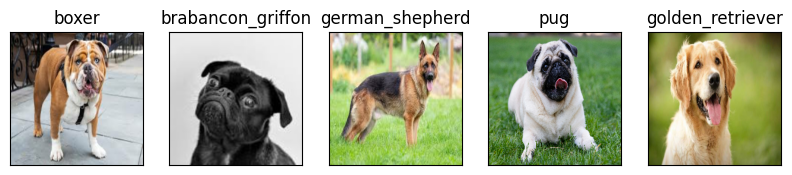

In [111]:
plt.figure(figsize=(12, 12))
for i, image in enumerate(custom_images):
  plt.subplot(1, 6, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)